<a href="https://colab.research.google.com/github/dhanushnayak/SSD_OBJECT_DETECTION/blob/main/SingalShot_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install tensorflow==2.8
!apt install --allow-change-held-packages libcudnn8=8.1.0.77-1+cuda11.2

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 668.3 MB 18 kB/s 
     |████████████████████████████████| 5.8 MB 10.9 MB/s 
     |████████████████████████████████| 462 kB 74.8 MB/s 
     |████████████████████████████████| 1.4 MB 59.6 MB/s 
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.9.1
    Uninstalling tensorboard-2.9.1:
      Successfully uninstalled tensorboard-2.9.1
  Attempting uninstall: keras
    Found existing installation: keras 2.9.0
    Uninstalling keras-2.9.0:
      Successfully uninstalled keras-2.9.0
  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.9.2
    Uninstalling tensorflow-2.9.2:
      Successfully uninstalled tensorflow-2.9.2
Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvi

In [ ]:
!pip install tf_slim

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 352 kB 29.5 MB/s 


In [ ]:
!pip install pycocotools

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import os # The os module in python provide function for creating and removing a directory (folder), fetching its content changing and identifying the current directory etc...
import pathlib

In [ ]:
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..') # Create new directory
elif not pathlib.Path("models").exists():
  !git clone --depth 1 https://github.com/tensorflow/models  # Clone git repo


Cloning into 'models'...
remote: Enumerating objects: 3494, done.
remote: Counting objects: 100% (3494/3494), done.
remote: Compressing objects: 100% (2907/2907), done.
remote: Total 3494 (delta 917), reused 1458 (delta 534), pack-reused 0
Receiving objects: 100% (3494/3494), 46.95 MiB | 13.28 MiB/s, done.
Resolving deltas: 100% (917/917), done.


In [ ]:
%%bash
cd models/research
protoc object_detection/protos/*.proto --python_out=.

In [ ]:
%%bash
cd /content/models/research/object_detection/packages/tf2
pip install .

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/models/research/object_detection/packages/tf2
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1236 sha256=e978e5a92ac611e62f0607de739a997e929f48d2fc07e4a5fbe68b3bde6b29b4
  Stored in directory: /tmp/pip-ephem-wheel-cache-vd3cq2b0/wheels/d3/af/d9/d9a25faaa2ce4aef17ef6a07f9bb33d386281f8f3580bce973
  Created wheel for py-cpuinfo: filename=py_cpuinfo-8.0.0-py3-none-any.whl size=22257 sha256=169ae84906b56b9443a513f2210992cab8333eab718ce3b51090b86044e1e9bf
  Stored in directory: /root/.cache/pip/wheels/d2/f1/1f/041add21dc9c4220157f1bd2bd6afe1f1a49524c3396b94401
  Created wheel for dill: filename=dill-0.3.1.1-py3-none-any.whl size=78544 sha256=ecad30b31c6b70502606f91df7e9aa0788b21c00e4c3c85ba51a6c879734220b
  Stored in directory: /root/.cache/pip/wheels/a4/61/fd/c57e374e580aa78a45ed78d5859b3a44436af17e22ca53284f
  Created wheel for av

  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.


In [ ]:
import numpy as np
import six.moves.urllib as urlib  #Navigate the url
import sys  # navigate the system resources
import tarfile # load file in tar format (Just like zip)
import tensorflow as tf
import zipfile
from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display

In [ ]:
cd /content/models/research

/content/models/research


In [ ]:
from object_detection.utils import ops as utils_ops, label_map_util, visualization_utils as vis_utils

In [ ]:
utils_ops.tf = tf.compat.v1

tf.gfile = tf.io.gfile

In [ ]:
def load_model(model_name):
  base_url='http://download.tensorflow.org/models/object_detection/tf2/20200711/'
  
  model_file=model_name+'.tar.gz'
  model_dir=tf.keras.utils.get_file(fname=model_name,origin=base_url+ model_file,untar=True)

  model_dir=pathlib.Path(model_dir)/"saved_model"

  model=tf.saved_model.load(str(model_dir))
  return model

In [ ]:
PATH_TO_LABELS = '/content/models/research/object_detection/data/mscoco_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True) 

In [ ]:
PATH_TO_TEST_IMAGE_DIR = pathlib.Path('/content/models/research/object_detection/test_images')
TEST_IMAGE_PATH = sorted(list(PATH_TO_TEST_IMAGE_DIR.glob('*.jpg')))
TEST_IMAGE_PATH

[PosixPath('/content/models/research/object_detection/test_images/image1.jpg'),
 PosixPath('/content/models/research/object_detection/test_images/image2.jpg'),
 PosixPath('/content/models/research/object_detection/test_images/image3.jpg')]

In [ ]:
model_name = 'ssd_mobilenet_v2_320x320_coco17_tpu-8'
base_url='http://download.tensorflow.org/models/object_detection/tf2/20200711/'
model_file=model_name+'.tar.gz'

In [ ]:
model_file

'ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz'

In [ ]:
model_dir = tf.keras.utils.get_file(model_file,base_url+model_file,untar=True)
model_dir=pathlib.Path(model_dir)/"saved_model"

46042990/46042990 [==============================] - 1s 0us/step


In [ ]:
model=tf.saved_model.load(str(model_dir))

In [ ]:
model.signatures['serving_default'].inputs


[<tf.Tensor 'input_tensor:0' shape=(1, None, None, 3) dtype=uint8>,
 <tf.Tensor 'unknown:0' shape=<unknown> dtype=resource>,
 <tf.Tensor 'unknown_0:0' shape=<unknown> dtype=resource>,
 <tf.Tensor 'unknown_1:0' shape=<unknown> dtype=resource>,
 <tf.Tensor 'unknown_2:0' shape=<unknown> dtype=resource>,
 <tf.Tensor 'unknown_3:0' shape=<unknown> dtype=resource>,
 <tf.Tensor 'unknown_4:0' shape=<unknown> dtype=resource>,
 <tf.Tensor 'unknown_5:0' shape=<unknown> dtype=resource>,
 <tf.Tensor 'unknown_6:0' shape=<unknown> dtype=resource>,
 <tf.Tensor 'unknown_7:0' shape=<unknown> dtype=resource>,
 <tf.Tensor 'unknown_8:0' shape=<unknown> dtype=resource>,
 <tf.Tensor 'unknown_9:0' shape=<unknown> dtype=resource>,
 <tf.Tensor 'unknown_10:0' shape=<unknown> dtype=resource>,
 <tf.Tensor 'unknown_11:0' shape=<unknown> dtype=resource>,
 <tf.Tensor 'unknown_12:0' shape=<unknown> dtype=resource>,
 <tf.Tensor 'unknown_13:0' shape=<unknown> dtype=resource>,
 <tf.Tensor 'unknown_14:0' shape=<unknown> dt

In [ ]:
model.signatures['serving_default'].output_dtypes

{'num_detections': tf.float32,
 'detection_scores': tf.float32,
 'raw_detection_scores': tf.float32,
 'detection_anchor_indices': tf.float32,
 'detection_multiclass_scores': tf.float32,
 'raw_detection_boxes': tf.float32,
 'detection_classes': tf.float32,
 'detection_boxes': tf.float32}

In [ ]:
model.signatures['serving_default'].output_shapes

{'num_detections': TensorShape([1]),
 'detection_scores': TensorShape([1, 100]),
 'raw_detection_scores': TensorShape([1, 1917, 91]),
 'detection_anchor_indices': TensorShape([1, 100]),
 'detection_multiclass_scores': TensorShape([1, 100, 91]),
 'raw_detection_boxes': TensorShape([1, 1917, 4]),
 'detection_classes': TensorShape([1, 100]),
 'detection_boxes': TensorShape([1, 100, 4])}

In [ ]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image) # Image convert into array
  input_tensor = tf.convert_to_tensor(image) # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = input_tensor[tf.newaxis,...] # The model expects a batch of images, so add an axis with `tf.newaxis`.
  print(input_tensor.shape)
  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)
  print(output_dict)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections


  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

In [ ]:
def show_inference(model, image_path):
  image_np = np.array(Image.open(image_path)) # the array based representation of the image will be used later in order to prepare the result image with boxes and labels on it.
  
  
  # Actual detection.
  output_dict = run_inference_for_single_image(model, image_np)


  # Visualization of the results of a detection.
  vis_utils.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)

  display(Image.fromarray(image_np))

(1, 636, 1024, 3)
{'num_detections': <tf.Tensor: shape=(1,), dtype=float32, numpy=array([100.], dtype=float32)>, 'detection_scores': <tf.Tensor: shape=(1, 100), dtype=float32, numpy=
array([[0.81329024, 0.74667627, 0.5432796 , 0.47883928, 0.4474388 ,
        0.4253799 , 0.41196474, 0.37142372, 0.36029217, 0.35952842,
        0.3521815 , 0.34820628, 0.34369975, 0.32248554, 0.31416863,
        0.30613023, 0.30015862, 0.29822436, 0.28763857, 0.28359127,
        0.28220233, 0.2799539 , 0.27635995, 0.27472085, 0.26243177,
        0.26230368, 0.25267482, 0.25143903, 0.24967593, 0.24802352,
        0.24096133, 0.23387219, 0.23028211, 0.22620842, 0.22465602,
        0.22416338, 0.22233786, 0.22119682, 0.21588092, 0.21293075,
        0.21280043, 0.21206689, 0.21135004, 0.21122427, 0.2066331 ,
        0.20465359, 0.2022684 , 0.20072302, 0.19569835, 0.19218652,
        0.19145858, 0.19113635, 0.18808214, 0.18708043, 0.18544863,
        0.18376422, 0.18321078, 0.18297075, 0.18266201, 0.18168588,
 

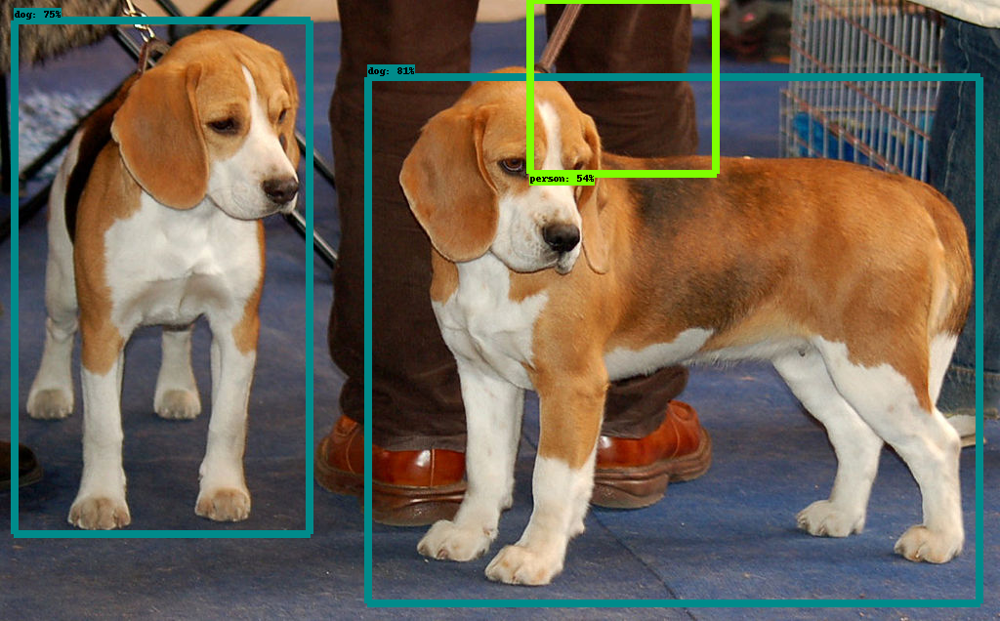

(1, 900, 1352, 3)
{'num_detections': <tf.Tensor: shape=(1,), dtype=float32, numpy=array([100.], dtype=float32)>, 'detection_scores': <tf.Tensor: shape=(1, 100), dtype=float32, numpy=
array([[0.7444057 , 0.72525656, 0.7052259 , 0.6869722 , 0.67375815,
        0.6627654 , 0.6147358 , 0.5862802 , 0.5850391 , 0.5605336 ,
        0.5179479 , 0.5069345 , 0.5000679 , 0.48101184, 0.47444403,
        0.452998  , 0.44629133, 0.44570565, 0.43814525, 0.42054054,
        0.41863286, 0.41534704, 0.40598443, 0.40214735, 0.3892091 ,
        0.36800784, 0.36328757, 0.36246398, 0.3533172 , 0.35266736,
        0.34604418, 0.34124485, 0.33427617, 0.3328894 , 0.3228944 ,
        0.31714022, 0.31609067, 0.31595996, 0.31418362, 0.31231037,
        0.30173415, 0.29709643, 0.2944245 , 0.2911594 , 0.2893372 ,
        0.28735206, 0.2849225 , 0.28400669, 0.28334692, 0.28058758,
        0.27845258, 0.27831283, 0.27753636, 0.2761208 , 0.27596796,
        0.27389404, 0.2714501 , 0.27119294, 0.26830304, 0.26448476,
 

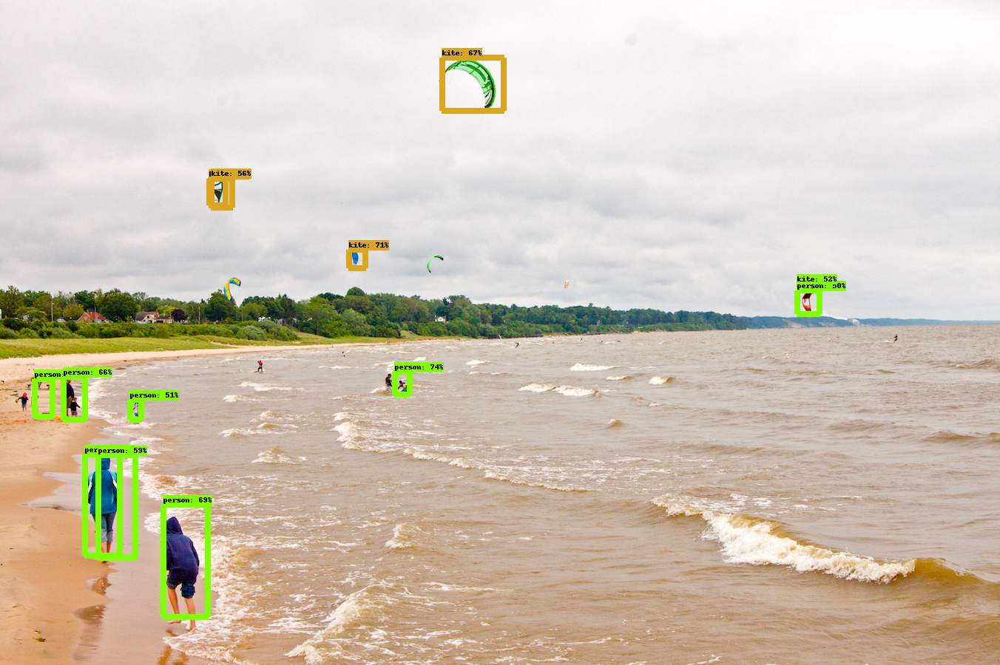

(1, 2886, 1920, 3)
{'num_detections': <tf.Tensor: shape=(1,), dtype=float32, numpy=array([100.], dtype=float32)>, 'detection_scores': <tf.Tensor: shape=(1, 100), dtype=float32, numpy=
array([[0.6493203 , 0.37631467, 0.3308426 , 0.3013357 , 0.29585218,
        0.29275844, 0.28999448, 0.28616095, 0.27614322, 0.27344298,
        0.26662222, 0.2655419 , 0.26339996, 0.2597538 , 0.2500498 ,
        0.24751471, 0.245849  , 0.24115904, 0.23863842, 0.2304352 ,
        0.2266085 , 0.22013004, 0.22011673, 0.21982673, 0.21743943,
        0.21505286, 0.21232165, 0.21201532, 0.21163453, 0.2101448 ,
        0.20909038, 0.20883487, 0.20245259, 0.20235276, 0.19935906,
        0.19689827, 0.19629572, 0.19533966, 0.19499266, 0.19498251,
        0.19400445, 0.19170375, 0.19077754, 0.19008824, 0.18287945,
        0.18040693, 0.17731959, 0.1768567 , 0.17362404, 0.17344955,
        0.1724911 , 0.17146215, 0.17054567, 0.1700049 , 0.16884819,
        0.16509837, 0.16482964, 0.1643367 , 0.1633693 , 0.16306143,


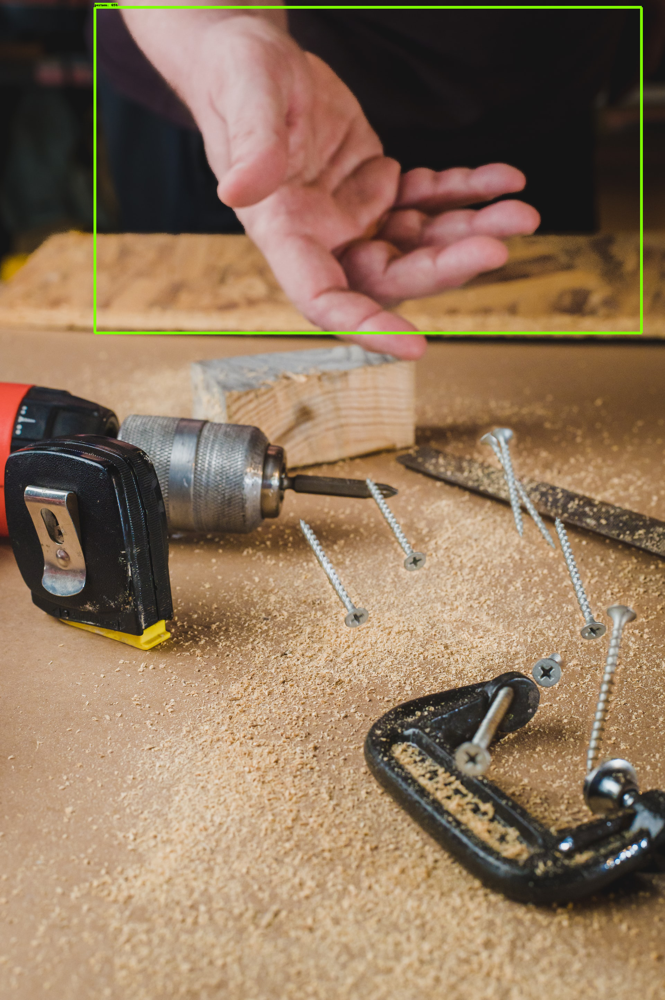

In [ ]:
for image_path in TEST_IMAGE_PATH:
  show_inference(model, image_path)

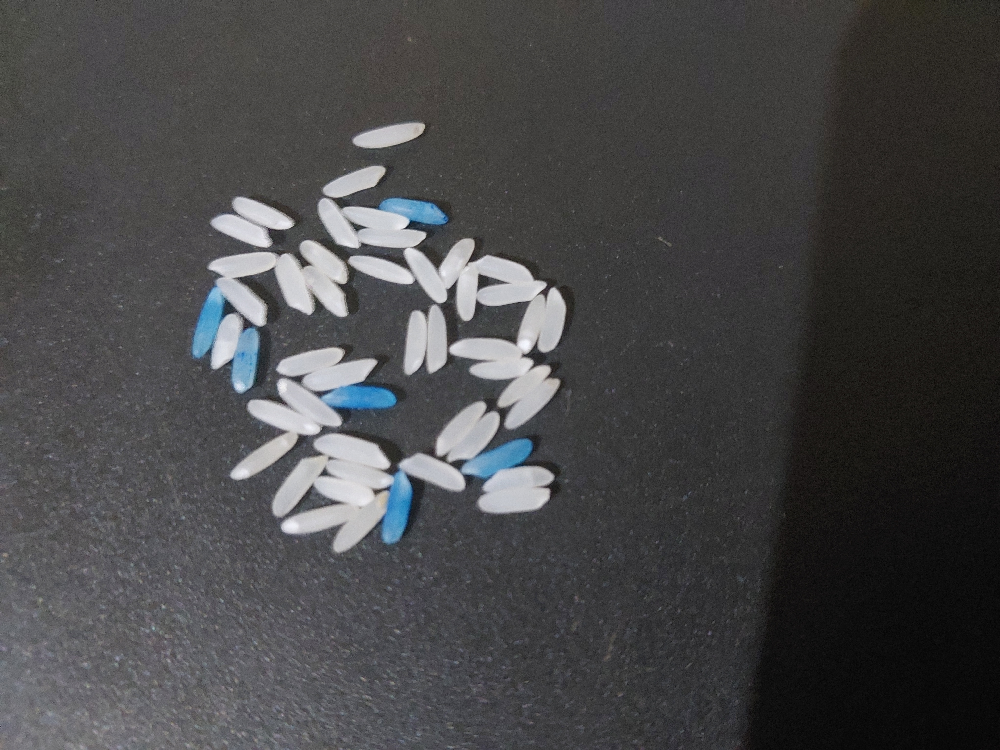

In [ ]:
show_inference(model,'/content/20220917_002458.jpg')